In [1]:
pip install xgboost

In [11]:
import pandas as pd
import numpy as np
import math
import datetime as dt

import matplotlib.pyplot as plt
from itertools import cycle
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import seaborn as sns

from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, accuracy_score
from sklearn.preprocessing import MinMaxScaler

from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=True)

In [3]:
df=pd.read_csv("/content/drive/MyDrive/Gemini Dataset proj/Gemini_BTCUSD_1h.csv")

In [4]:
df.head()

,unix,date,symbol,open,high,low,close,Volume BTC,Volume USD
0,1.692570e+12,20-08-2023 23:00,BTC/USD,26210.24,26210.26,26154.33,26187.84,11.409621,298793.32210
1,1.692570e+12,20-08-2023 22:00,BTC/USD,26186.93,26229.40,26185.83,26210.24,4.107410,107656.20820
2,1.692570e+12,20-08-2023 21:00,BTC/USD,26232.97,26244.73,26158.38,26186.93,2.790396,73071.90289
3,1.692560e+12,20-08-2023 20:00,BTC/USD,26142.63,26288.00,26142.63,26232.97,1.673166,43892.11348
4,1.692560e+12,20-08-2023 19:00,BTC/USD,26118.02,26147.36,26114.27,26142.63,5.536223,144731.43110


In [5]:
df=df.iloc[::-1]

In [6]:
df.head()

,unix,date,symbol,open,high,low,close,Volume BTC,Volume USD
68959,1.444309e+09,08-10-2015 13:00,BTC/USD,0.00,245.00,0.00,245.00,0.606654,148.630323
68958,1.444313e+09,08-10-2015 14:00,BTC/USD,245.00,245.00,244.50,245.00,4.453649,1091.143988
68957,1.444316e+09,08-10-2015 15:00,BTC/USD,245.00,245.00,244.92,244.92,3.016926,738.905474
68956,1.444320e+09,08-10-2015 16:00,BTC/USD,244.92,244.92,244.25,244.25,3.895252,951.415413
68955,1.444324e+09,08-10-2015 17:00,BTC/USD,244.25,244.99,244.02,244.99,3.920632,960.515634


In [27]:
df=df[['date','close']]

In [28]:
df.columns

Index(['date', 'close'], dtype='object')

In [29]:
df.describe()

,close
count,68960.000000
mean,15619.330672
std,16208.543712
min,243.600000
25%,3609.767500
50%,9115.610000
75%,23704.007500
max,68636.960000


In [30]:
print("Starting date: ",df.iloc[0][1])
print("Ending date: ", df.iloc[-1][1])
#print("Duration: ", df.iloc[-1][1]-df.iloc[0][1])

Starting date:  245.0
Ending date:  26187.84


In [31]:
df_close=df.copy()

In [32]:
del df_close['date']

In [33]:
df_close.shape

(68960, 1)

In [34]:
scaler=MinMaxScaler(feature_range=(0,1))
df_close=scaler.fit_transform(np.array(df_close).reshape(-1,1))
print(df_close.shape)

(68960, 1)


In [35]:
training_size=int(len(df_close)*0.75)
test_size=len(df_close)-training_size


train_data,test_data=df_close[0:training_size,:],df_close[training_size:len(df_close),:1]


print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (51720, 1)
test_data:  (17240, 1)


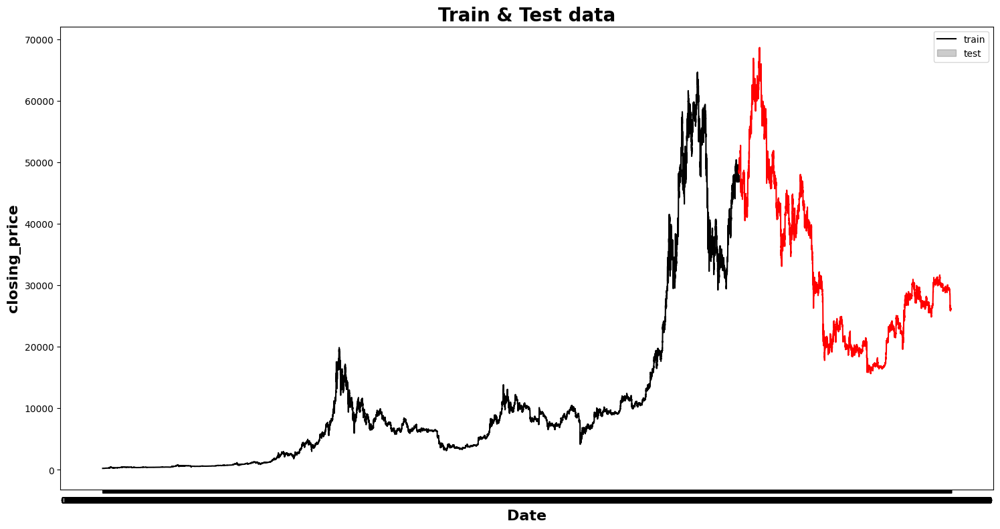

In [36]:
fig, ax = plt.subplots(figsize=(18, 9))

sns.lineplot(x = df['date'][:51720], y = df['close'][:51720], color = 'black')
sns.lineplot(x = df['date'][51720:], y = df['close'][51720:], color = 'red')

# Formatting
ax.set_title('Train & Test data', fontsize = 20, loc='center', fontdict=dict(weight='bold'))
ax.set_xlabel('Date', fontsize = 16, fontdict=dict(weight='bold'))
ax.set_ylabel('closing_price', fontsize = 16, fontdict=dict(weight='bold'))
#plt.tick_params(axis='y', which='major', labelsize=16)
#plt.tick_params(axis='x', which='major', labelsize=16)
plt.legend(loc='upper right' ,labels = ('train', 'test'))
plt.show()

In [37]:
# Prepare train data for time series analysis
# convert an array of values into a dataset matrix
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [38]:
time_step = 360
X_train, y_train = create_dataset(train_data, time_step)
X_test, y_test = create_dataset(test_data, time_step)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test", y_test.shape)

X_train:  (51359, 360)
y_train:  (51359,)
X_test:  (16879, 360)
y_test (16879,)


The time_step variable represents the number of time steps (i.e., days) to use as input to the model for predicting the next day's BTC price. In other words, if time_step is 21, then the model will use the previous 21 days of BTC prices as input to predict the price on the 22nd day.

The function first initializes two empty lists, X and y, to store the input/output pairs. It then loops over the indices of data from 0 to len(data)-time_step, and for each index i, it appends a sequence of time_step consecutive data points starting at index i to X, and the next data point (i.e., the target variable) to y. Finally, it converts X and y to NumPy arrays and returns them.

For example, suppose we have the following data array:

data = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10]) If we call create_dataset(data, time_step=3), the function will return:

(array([[1, 2, 3], [2, 3, 4], [3, 4, 5], [4, 5, 6], [5, 6, 7], [6, 7, 8]]), array([4, 5, 6, 7, 8, 9])) In this example, X contains 6 rows, each corresponding to a sequence of 3 consecutive data points from data, and y contains the next data point in the time series after each sequence. These input/output pairs can be used to train an ML/ DL model to predict the next data point in the time series given the previous time_step data points.

In [39]:

# Biulding Model
my_model = XGBRegressor(n_estimators=200)
my_model.fit(X_train, y_train, verbose=False)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=200, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [40]:
predictions = my_model.predict(X_test)
print("Mean Absolute Error - MAE : " + str(mean_absolute_error(y_test, predictions)))
print("Root Mean squared Error - RMSE : " + str(math.sqrt(mean_squared_error(y_test, predictions))))

Mean Absolute Error - MAE : 0.011053768100370748
Root Mean squared Error - RMSE : 0.016351884468737688


In [41]:
train_predict=my_model.predict(X_train)
test_predict=my_model.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (51359, 1)
Test data prediction: (16879, 1)


In [42]:

# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

In [43]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(df_close)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)



Train predicted data:  (68960, 1)


In [45]:
# shift test predictions for plotting
testPredictPlot = np.empty_like(df_close)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(df_close)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)



Test predicted data:  (68960, 1)


In [49]:
print("Train data R2 score:", r2_score(original_ytrain, train_predict))
print("Test data R2 score:", r2_score(original_ytest, test_predict))

Train data R2 score: 0.999973001210687
Test data R2 score: 0.9921284954835673


In [48]:
names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'date': df['date'],
                       'original_close': df['close'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Close price','date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

In [50]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_days = 10
while(i<pred_days):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} day input {}".format(i,x_input))
        x_input=x_input.reshape(1,-1)

        yhat = my_model.predict(x_input)
        #print("{} day output {}".format(i,yhat))
        temp_input.extend(yhat.tolist())
        temp_input=temp_input[1:]

        lst_output.extend(yhat.tolist())
        i=i+1

    else:
        yhat = my_model.predict(x_input)

        temp_input.extend(yhat.tolist())
        lst_output.extend(yhat.tolist())

        i=i+1

print("Output of predicted next days: ", len(lst_output))


Output of predicted next days:  10


In [51]:
last_days=np.arange(1,time_step+1)
day_pred=np.arange(time_step+1,time_step+pred_days+1)
print(last_days)
print(day_pred)

[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234
 235 236 237 238 239 240 241 242 243 244 245 246 24

In [52]:
temp_mat = np.empty((len(last_days)+pred_days+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_days_value = temp_mat
next_predicted_days_value = temp_mat

last_original_days_value[0:time_step+1] = scaler.inverse_transform(df_close[len(df_close)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_days_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

new_pred_plot = pd.DataFrame({
    'last_original_days_value':last_original    _days_value,
    'next_predicted_days_value':next_predicted_days_value
})

names = cycle(['Last 15 days close price','Predicted next 10 days close price'])

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_days_value'],
                                                      new_pred_plot['next_predicted_days_value']],
              labels={'value': 'Close price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 15 days vs next 10 days',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()